In [1]:
!pip install xlrd
!pip install ydata-profiling
!pip install scikeras


In [18]:
import pandas as pd
from ydata_profiling import ProfileReport

# for deep learning:
import tensorflow as tf
import numpy as np

from tensorflow import keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Dropout
from tensorflow.keras.layers import BatchNormalization, Flatten
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Reshape # new!
from tensorflow.keras.layers import Conv2DTranspose, UpSampling2D #new!
from tensorflow.keras.optimizers import RMSprop # new!
# for plotting:
import pandas as pd
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
# Carga del archivo Excel en un df
file_path = "default of credit card clients.xls"
df = pd.read_excel(file_path, header=1)

# Mostrar las primeras filas del DataFrame para asegurarse de que se haya cargado correctamente
print(df.head())

   ID  LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  PAY_4  \
0   1      20000    2          2         1   24      2      2     -1     -1   
1   2     120000    2          2         2   26     -1      2      0      0   
2   3      90000    2          2         2   34      0      0      0      0   
3   4      50000    2          2         1   37      0      0      0      0   
4   5      50000    1          2         1   57     -1      0     -1      0   

   ...  BILL_AMT4  BILL_AMT5  BILL_AMT6  PAY_AMT1  PAY_AMT2  PAY_AMT3  \
0  ...          0          0          0         0       689         0   
1  ...       3272       3455       3261         0      1000      1000   
2  ...      14331      14948      15549      1518      1500      1000   
3  ...      28314      28959      29547      2000      2019      1200   
4  ...      20940      19146      19131      2000     36681     10000   

   PAY_AMT4  PAY_AMT5  PAY_AMT6  default payment next month  
0         0         0   

### Entendiemiento y perfilamiento de los datos
Se utilizo la libreria xxxxxxxxxx para realizar el perfilamiento de los datos, esta libreria nos permite conocer caracteristicas de cada una de las variables, así como tendencias, outliers, valores vacios o nulos, etc.

In [3]:
#Entendimiento de los datos
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Por medio de los resultados del perfilamiento de datos es posible apreciar que no se presentan datos nulos, filas repetidas, outliers o datos anomalos. Por otro lado, se evidencia una baja correlación entre las diferentes variables con la variable de default (nuestra variable de interés para dar respuesta a las preguntas). No obstante, es posible apreciar que algunos datos cuentan con escalas variadas, dado la naturaleza númerica o categorica de algunas variables. Por esta razón, es una buena practica realizar un proceso de normalización de los datos para mejorar el proceso de entrenamiento y evitar que valores con mangitudes considerablemente grandes afecten dicho proceso y por consiguiente los resultados.

Se le realiza la división de los conjutos de prueba, entrenamiento y validación, utilizando la semilla 42 y un 20% para el conjunto de test, el conjunto de entrenamiento es nuevamente divido para obtener el conjunto de validación.

In [4]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df, test_size=0.2, random_state=42)
y_test = test['default payment next month']
X_test = test.drop(columns=['default payment next month'])
y_train = train['default payment next month']
X_train = train.drop(columns=['default payment next month'])
X_train_F, X_valid_F = X_train[:-12000], X_train[-12000:]
y_train_F, y_valid_F = y_train[:-12000], y_train[-12000:]


In [5]:
print(X_test.shape)
print(X_valid_F.shape)
print(X_train_F.shape)

(6000, 24)
(12000, 24)
(12000, 24)


In [6]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_test_scaled = scaler.fit_transform(X_test)
X_train_scaled = scaler.fit_transform(X_train_F)
X_valid_scaled = scaler.fit_transform(X_valid_F)
X_test_scaled = scaler.transform(X_test)
X_train_scaled = scaler.transform(X_train_F)
X_valid_scaled = scaler.transform(X_valid_F)

In [7]:
train_tf = tf.data.Dataset.from_tensor_slices((X_train_scaled, y_train_F))

Esta investigación empleó una variable binaria, pago por defecto (Sí = 1, No = 0), la cual será la variable predictiva para nuestro cliente.

Por otra parte, en cuanto a las variables explicativas se cuenta con 23 variables explicativas, las cuales estan descritas a continuación:

X1: Monto del crédito otorgado (en dólares taiwaneses): incluye tanto el crédito individual del consumidor como el crédito familiar (suplementario).
X2: Género (1 = masculino; 2 = femenino).
X3: Educación (1 = escuela de posgrado; 2 = universidad; 3 = escuela secundaria; 4 = otros).
X4: Estado civil (1 = casado; 2 = soltero; 3 = otros).
X5: Edad (año).
X6 - X11: Historial de pagos pasados. Se rastrearon los registros de pago mensual pasados (de abril a septiembre de 2005) de la siguiente manera:
    X6 = estado de pago en septiembre de 2005; 
    X7 = estado de pago en agosto de 2005; ...; 
    X11 = estado de pago en abril de 2005. 
    La escala de medición para el estado de pago es: -1 = paga puntualmente; 1 = retraso de pago de un mes; 2 = retraso de pago de dos meses; ...; 8 = retraso de pago de ocho meses; 9 = retraso de pago de nueve meses y más.
X12-X17: Monto del estado de cuenta (en dólares taiwaneses). 
    X12 = monto del estado de cuenta en septiembre de 2005; 
    X13 = monto del estado de cuenta en agosto de 2005; ...; 
    X17 = monto del estado de cuenta en abril de 2005.
X18-X23: Monto del pago anterior (en dólares taiwaneses). 
    X18 = monto pagado en septiembre de 2005; X19 = monto pagado en agosto de 2005; ...; 
    X23 = monto pagado en abril de 2005.

In [8]:
# Convertir DataFrame a tensor
input_tensor = tf.constant(X_train_scaled)

# Obtener la forma del tensor
input_Shape = input_tensor.shape[1:]


In [9]:
input_tensor

<tf.Tensor: shape=(12000, 24), dtype=float64, numpy=
array([[ 0.76766127, -0.67686977,  0.81692191, ..., -0.22259018,
        -0.21311253, -0.24690351],
       [-1.70769798, -1.06321244, -1.22410722, ..., -0.238934  ,
        -0.30293356, -0.29805144],
       [ 0.90442654,  0.09581556,  0.81692191, ...,  0.12933034,
         0.33979966, -0.28744902],
       ...,
       [ 0.81889068,  1.64118622,  0.81692191, ...,  0.23932492,
         0.22735243,  0.10821929],
       [ 1.33325703, -1.14048097, -1.22410722, ..., -0.29206698,
        -0.30293356, -0.29805144],
       [ 0.56585191,  0.40488969,  0.81692191, ..., -0.18443386,
         0.00792803,  0.3026164 ]])>

In [23]:
from keras.optimizers import Adam
def crear_modelo(depth=24, p=0.4, alpha=0.001, input_shape=None):
    # Capa de entrada
    input_layer = Input(shape=input_shape)

    # Capas densas
    dense1 = Dense(depth, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(p)(dense1)

    dense2 = Dense(depth, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(p)(dense2)

    dense3 = Dense(depth, activation='relu')(dense1)
    dense3 = BatchNormalization()(dense3)
    dense3 = Dropout(p)(dense3)

    # Capa de salida
    prediction = Dense(1, activation='sigmoid')(dense3)

    # Definición del modelo
    optimizer = Adam(learning_rate=alpha)
    model = Model(inputs=input_layer, outputs=prediction)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Convertir DataFrame a tensor
input_tensor = tf.constant(X_train_scaled)

# Obtener la forma del tensor
input_shape = input_tensor.shape[1:]

# Crear el modelo
modelo = crear_modelo(input_shape=input_shape)


In [24]:
early = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience=5)

In [25]:
history_base = modelo.fit(X_train_scaled, y_train_F, validation_data= (X_valid_scaled, y_valid_F), batch_size=40, epochs = 40, callbacks=[early])

Epoch 1/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.6117 - loss: 0.7294 - val_accuracy: 0.8014 - val_loss: 0.4806
Epoch 2/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7809 - loss: 0.5236 - val_accuracy: 0.8048 - val_loss: 0.4633
Epoch 3/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7921 - loss: 0.5021 - val_accuracy: 0.8045 - val_loss: 0.4585
Epoch 4/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8015 - loss: 0.4840 - val_accuracy: 0.8049 - val_loss: 0.4560
Epoch 5/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8026 - loss: 0.4686 - val_accuracy: 0.8052 - val_loss: 0.4544
Epoch 6/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8123 - loss: 0.4574 - val_accuracy: 0.8069 - val_loss: 0.4522
Epoch 7/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8136 - loss: 0.4561 - val_accuracy: 0.8079 - val_loss: 0.4512
Epoch 8/40
300/300 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8123 - loss: 0.4511 - val_accuracy: 0.

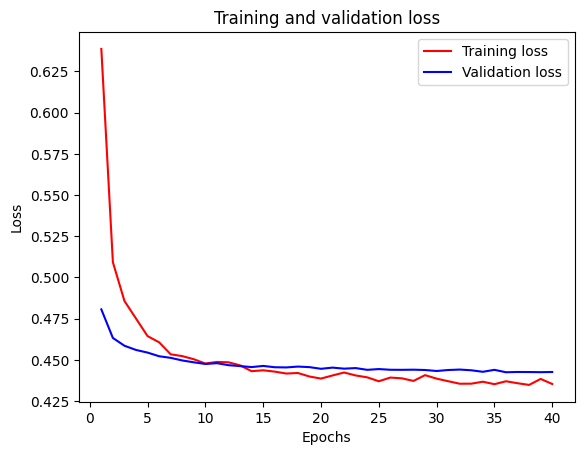

In [26]:
## Plotting the training and validation loss:
import matplotlib.pyplot as plt
history_dict = history_base.history
loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)
plt.plot(epochs, loss_values, 'r', label='Training loss')
plt.plot(epochs, val_loss_values, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Evaluación del modelo en el conjunto de test

In [27]:
test = modelo.evaluate(X_test, y_test)

188/188 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7625 - loss: 706.5474


In [28]:
pred1 = modelo.predict(X_test)
# Set threshold
threshold = 0.5

# Apply threshold to classify instances
pred1 = np.where(pred1 >= threshold, 1, 0)


188/188 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [29]:
pred1

array([[0],
       [0],
       [0],
       ...,
       [0],
       [0],
       [0]])

In [30]:
from sklearn.metrics import classification_report
print(classification_report(y_test,pred1))

              precision    recall  f1-score   support

           0       0.79      0.96      0.86      4687
           1       0.31      0.06      0.10      1313

    accuracy                           0.76      6000
   macro avg       0.55      0.51      0.48      6000
weighted avg       0.68      0.76      0.70      6000



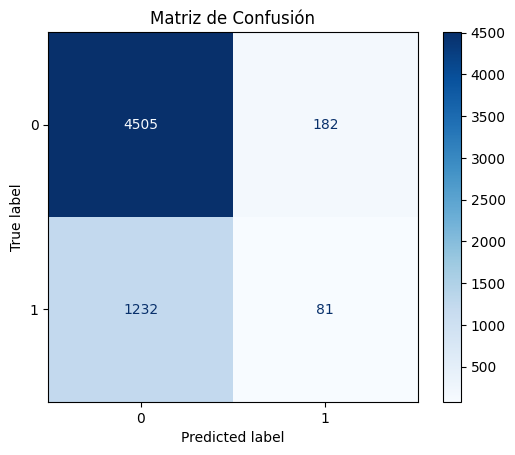

In [31]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

conf_matrix = confusion_matrix(y_test, pred1)
disp = ConfusionMatrixDisplay(conf_matrix)
disp.plot(cmap='Blues', values_format='d')
# Añade etiquetas y muestra el gráfico
plt.title('Matriz de Confusión')
plt.show()